<a href="https://colab.research.google.com/github/JanelaCusi-03/Tesis-unsaac/blob/main/ECModelos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Descarga de tesis

Mi recolección de datos consiste en un proceso automatizado que extrae información de las tesis publicadas en el repositorio institucional de la UNSAAC. Para ello, el script recorre todas las páginas del repositorio, obtiene los enlaces de cada tesis y, utilizando la librería BeautifulSoup, extrae datos relevantes como el título, facultad, escuela, año, resumen, palabras clave y enlace al PDF. Cada registro se almacena en una estructura de datos y, al finalizar, toda la información recolectada se guarda en un archivo CSV llamado tesis_unsaac.csv para su posterior análisis.

In [ ]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import time

class DatosTesis:
    def __init__(self, universidad, url):
        self.pUniversidad = universidad
        self.pId = 'tesis_' + url.split('/')[-1]
        self.pFacultad = ""
        self.pEscuela = ""
        self.pUrl = url
        self.pUrlPdf = None
        self.pResumen = ""
        self.pPalabrasClave = ""
        self.pTituloTesis = ""
        self.pAnio = ""

    def limpiar_palabras_clave(self, palabras):
        return palabras.replace("info:eu-repo/semantics/bachelorThesis", "").strip()

    def procesar_solicitud(self):
        try:
            response = requests.get(self.pUrl)
            response.raise_for_status()
            soup = BeautifulSoup(response.content, "html.parser")

            trail = soup.find_all('ul', class_="breadcrumb")
            if trail:
                trail_text = [a.text.strip() for a in trail[0].find_all("a")]
                if len(trail_text) >= 3:
                    self.pFacultad = trail_text[-3]
                    self.pEscuela = trail_text[-2]

            self.pUrlPdf = soup.find('meta', attrs={'name': 'citation_pdf_url'})['content'] if soup.find('meta', attrs={'name': 'citation_pdf_url'}) else None
            self.pResumen = soup.find('meta', attrs={'name': 'DCTERMS.abstract'})['content'] if soup.find('meta', attrs={'name': 'DCTERMS.abstract'}) else ""
            palabras_clave = soup.find('meta', attrs={'name': 'citation_keywords'})
            self.pPalabrasClave = self.limpiar_palabras_clave(palabras_clave['content']) if palabras_clave else ""
            self.pTituloTesis = soup.find('meta', attrs={'name': 'citation_title'})['content'] if soup.find('meta', attrs={'name': 'citation_title'}) else ""
            fecha = soup.find('meta', attrs={'name': 'citation_date'})
            self.pAnio = fecha['content'].split("-")[0] if fecha else ""

        except Exception as e:
            print(f"Error procesando {self.pUrl}: {e}")

# Etapa única: recolectar y procesar todas las tesis disponibles
lista_tesis = []
offset = 0

while True:
    url = f"https://repositorio.unsaac.edu.pe/recent-submissions?offset={offset}"
    print(f"\nProcesando página con offset {offset}...")
    response = requests.get(url)
    if response.status_code != 200:
        print(f"Error o fin de páginas. Código: {response.status_code}")
        break

    soup = BeautifulSoup(response.content, 'html.parser')
    links = [a['href'] for a in soup.select('h4.artifact-title > a')]

    if not links:
        print("No se encontraron más tesis.")
        break

    for link in links:
        id_tesis = link.split('/')[-1]
        url_tesis = f"https://repositorio.unsaac.edu.pe/handle/20.500.12918/{id_tesis}"
        tesis = DatosTesis("UNSAAC", url_tesis)
        tesis.procesar_solicitud()
        lista_tesis.append(tesis)
        print(f"Total recolectadas: {len(lista_tesis)}")
        time.sleep(0.5)  # Espera entre tesis

    offset += 20
    time.sleep(1)  # Espera entre páginas

# Exportar a CSV
df = pd.DataFrame([{
    "Id": t.pId,
    "Titulo": t.pTituloTesis,
    "Escuela": t.pEscuela,
    "Facultad": t.pFacultad,
    "Anio": t.pAnio,
    "URL": t.pUrl,
    "URL_PDF": t.pUrlPdf,
    "Palabras_clave": t.pPalabrasClave,
    "Resumen": t.pResumen
} for t in lista_tesis])

df.to_csv("tesis_unsaac.csv", index=False, encoding='utf-8-sig')
print(f"\n📁 Archivo 'tesis_unsaac.csv' guardado exitosamente con {len(lista_tesis)} tesis.")



Procesando página con offset 0...
Total recolectadas: 1
Total recolectadas: 2
Total recolectadas: 3
Total recolectadas: 4
Total recolectadas: 5
Total recolectadas: 6
Total recolectadas: 7
Total recolectadas: 8
Total recolectadas: 9
Total recolectadas: 10
Total recolectadas: 11
Total recolectadas: 12
Total recolectadas: 13
Total recolectadas: 14
Total recolectadas: 15
Total recolectadas: 16
Total recolectadas: 17
Total recolectadas: 18
Total recolectadas: 19
Total recolectadas: 20

Procesando página con offset 20...
Total recolectadas: 21
Total recolectadas: 22
Total recolectadas: 23
Total recolectadas: 24
Total recolectadas: 25
Total recolectadas: 26
Total recolectadas: 27
Total recolectadas: 28
Total recolectadas: 29
Total recolectadas: 30
Total recolectadas: 31
Total recolectadas: 32
Total recolectadas: 33
Total recolectadas: 34
Total recolectadas: 35
Total recolectadas: 36
Total recolectadas: 37
Total recolectadas: 38
Total recolectadas: 39
Total recolectadas: 40

Procesando página

Se truncaron las últimas líneas 5000 del resultado de transmisión.

Procesando página con offset 1460...
Total recolectadas: 1461
Total recolectadas: 1462
Total recolectadas: 1463
Total recolectadas: 1464
Total recolectadas: 1465
Total recolectadas: 1466
Total recolectadas: 1467
Total recolectadas: 1468
Total recolectadas: 1469
Total recolectadas: 1470
Total recolectadas: 1471
Total recolectadas: 1472
Total recolectadas: 1473
Total recolectadas: 1474
Total recolectadas: 1475
Total recolectadas: 1476
Total recolectadas: 1477
Total recolectadas: 1478
Total recolectadas: 1479
Total recolectadas: 1480

Procesando página con offset 1480...
Total recolectadas: 1481
Total recolectadas: 1482
Total recolectadas: 1483
Total recolectadas: 1484
Total recolectadas: 1485
Total recolectadas: 1486
Total recolectadas: 1487
Total recolectadas: 1488
Total recolectadas: 1489
Total recolectadas: 1490
Total recolectadas: 1491
Total recolectadas: 1492
Total recolectadas: 1493
Total recolectadas: 1494
Total r

Total recolectadas: 6004
Total recolectadas: 6005
Total recolectadas: 6006
Total recolectadas: 6007
Total recolectadas: 6008
Total recolectadas: 6009
Total recolectadas: 6010
Total recolectadas: 6011
Total recolectadas: 6012
Total recolectadas: 6013
Total recolectadas: 6014
Total recolectadas: 6015
Total recolectadas: 6016
Total recolectadas: 6017
Total recolectadas: 6018
Total recolectadas: 6019
Total recolectadas: 6020

Procesando página con offset 6020...
Total recolectadas: 6021
Total recolectadas: 6022
Total recolectadas: 6023
Total recolectadas: 6024
Total recolectadas: 6025
Total recolectadas: 6026
Total recolectadas: 6027
Total recolectadas: 6028
Total recolectadas: 6029
Total recolectadas: 6030
Total recolectadas: 6031
Total recolectadas: 6032
Total recolectadas: 6033
Total recolectadas: 6034
Total recolectadas: 6035
Total recolectadas: 6036
Total recolectadas: 6037
Total recolectadas: 6038
Total recolectadas: 6039
Total recolectadas: 6040

Procesando página con offset 6040...

Total recolectadas: 6299
Total recolectadas: 6300

Procesando página con offset 6300...
Total recolectadas: 6301
Total recolectadas: 6302
Total recolectadas: 6303
Total recolectadas: 6304
Total recolectadas: 6305
Total recolectadas: 6306
Total recolectadas: 6307
Total recolectadas: 6308
Total recolectadas: 6309
Total recolectadas: 6310
Total recolectadas: 6311
Total recolectadas: 6312
Total recolectadas: 6313
Total recolectadas: 6314
Total recolectadas: 6315
Total recolectadas: 6316
Total recolectadas: 6317
Total recolectadas: 6318
Total recolectadas: 6319
Total recolectadas: 6320

Procesando página con offset 6320...
Total recolectadas: 6321
Total recolectadas: 6322
Total recolectadas: 6323
Total recolectadas: 6324
Total recolectadas: 6325
Total recolectadas: 6326
Total recolectadas: 6327
Total recolectadas: 6328
Total recolectadas: 6329
Total recolectadas: 6330
Total recolectadas: 6331
Total recolectadas: 6332
Total recolectadas: 6333
Total recolectadas: 6334
Total recolectadas: 6335

Total recolectadas: 6428
Total recolectadas: 6429
Total recolectadas: 6430
Total recolectadas: 6431
Total recolectadas: 6432
Total recolectadas: 6433
Total recolectadas: 6434
Total recolectadas: 6435
Total recolectadas: 6436
Total recolectadas: 6437
Total recolectadas: 6438
Total recolectadas: 6439
Total recolectadas: 6440

Procesando página con offset 6440...
Total recolectadas: 6441
Total recolectadas: 6442
Total recolectadas: 6443
Total recolectadas: 6444
Total recolectadas: 6445
Total recolectadas: 6446
Total recolectadas: 6447
Total recolectadas: 6448
Total recolectadas: 6449
Total recolectadas: 6450
Total recolectadas: 6451
Total recolectadas: 6452
Total recolectadas: 6453
Total recolectadas: 6454
Total recolectadas: 6455
Total recolectadas: 6456
Total recolectadas: 6457
Total recolectadas: 6458
Total recolectadas: 6459
Total recolectadas: 6460

Procesando página con offset 6460...
Total recolectadas: 6461
Total recolectadas: 6462
Total recolectadas: 6463
Total recolectadas: 6464

Total recolectadas: 7769
Total recolectadas: 7770
Total recolectadas: 7771
Total recolectadas: 7772
Total recolectadas: 7773
Total recolectadas: 7774
Total recolectadas: 7775
Total recolectadas: 7776
Total recolectadas: 7777
Total recolectadas: 7778
Total recolectadas: 7779
Total recolectadas: 7780

Procesando página con offset 7780...
Total recolectadas: 7781
Total recolectadas: 7782
Total recolectadas: 7783
Total recolectadas: 7784
Total recolectadas: 7785
Total recolectadas: 7786
Total recolectadas: 7787
Total recolectadas: 7788
Total recolectadas: 7789
Total recolectadas: 7790
Total recolectadas: 7791
Total recolectadas: 7792
Total recolectadas: 7793
Total recolectadas: 7794
Total recolectadas: 7795
Total recolectadas: 7796
Total recolectadas: 7797
Total recolectadas: 7798
Total recolectadas: 7799
Total recolectadas: 7800

Procesando página con offset 7800...
Total recolectadas: 7801
Total recolectadas: 7802
Total recolectadas: 7803
Total recolectadas: 7804
Total recolectadas: 7805

Total recolectadas: 8773
Total recolectadas: 8774
Total recolectadas: 8775
Total recolectadas: 8776
Total recolectadas: 8777
Total recolectadas: 8778
Total recolectadas: 8779
Total recolectadas: 8780

Procesando página con offset 8780...
Total recolectadas: 8781
Total recolectadas: 8782
Total recolectadas: 8783
Total recolectadas: 8784
Total recolectadas: 8785
Total recolectadas: 8786
Total recolectadas: 8787
Total recolectadas: 8788
Total recolectadas: 8789
Total recolectadas: 8790
Total recolectadas: 8791
Total recolectadas: 8792
Total recolectadas: 8793
Total recolectadas: 8794
Total recolectadas: 8795
Total recolectadas: 8796
Total recolectadas: 8797
Total recolectadas: 8798
Total recolectadas: 8799
Total recolectadas: 8800

Procesando página con offset 8800...
Total recolectadas: 8801
Total recolectadas: 8802
Total recolectadas: 8803
Total recolectadas: 8804
Total recolectadas: 8805
Total recolectadas: 8806
Total recolectadas: 8807
Total recolectadas: 8808
Total recolectadas: 8809

Este fragmento de código corresponde a la **etapa de limpieza y filtrado** de los datos recolectados. En esta fase, se carga el archivo `tesis_unsaac.csv` generado previamente y se aplican varias transformaciones para mejorar la calidad de la información. Primero, se eliminan las comillas innecesarias en los campos *Título* y *Facultad*. Luego, se filtran únicamente las filas en las que el campo *Facultad* comienza con la palabra “Facultad”, descartando registros vacíos o incorrectos. Posteriormente, se eliminan los títulos duplicados para conservar una sola versión de cada tesis. Finalmente, se guarda un nuevo archivo limpio llamado **`tesis_unsaac_filtrado.csv`** y se muestra un resumen con el número de tesis por facultad.


In [ ]:
import pandas as pd

# Cargar el CSV
df = pd.read_csv("tesis_unsaac.csv")

# Paso 1: Quitar comillas dobles o simples al inicio y final de 'Titulo' y 'Facultad'
df['Titulo'] = df['Titulo'].astype(str).str.strip(' "\'')
df['Facultad'] = df['Facultad'].astype(str).str.strip(' "\'')

# Paso 2: Filtrar filas donde 'Facultad' empieza con la palabra 'Facultad'
df = df[df['Facultad'].str.startswith("Facultad", na=False)]

# Paso 3: Eliminar duplicados por 'Titulo', conservar solo la primera aparición
df = df.drop_duplicates(subset='Titulo', keep='first')

# Guardar nuevo CSV limpio
df.to_csv("tesis_unsaac_filtrado.csv", index=False, encoding='utf-8-sig')
print(f"✅ Archivo limpio guardado con {len(df)} tesis únicas y válidas.")

# Mostrar facultades con mayor cantidad de tesis
print("\n📊 Cantidad de tesis por facultad:")
print(df['Facultad'].value_counts())


✅ Archivo filtrado guardado con 7739 tesis únicas y válidas.

📊 Cantidad de tesis por facultad:
Facultad
Facultad de Ciencias de la Salud                                         1345
Facultad de Ciencias Administrativas, Contables, Económicas y Turismo    1287
Facultad de Educación y Ciencias de la Comunicación                      1047
Facultad de Ciencias Agrarias                                             872
Facultad de Derecho y Ciencias Sociales                                   767
Facultad de Ingeniería Geológica, Minas y Metalúrgica                     691
Facultad de Arquitectura e Ing Civil                                      559
Facultad de Ingeniería Eléctrica, Electrónica, Informática y Mecánica     539
Facultad de Ciencias                                                      449
Facultad de Ingeniería de Procesos                                        183
Name: count, dtype: int64


# Embeddings

* BERTIN

  BERTIN-project/bertin-roberta-base-spanish
* MiniLM

  jaimevera1107/all-MiniLM-L6-v2-similarity-es
* RoBERTa

  PlanTL-GOB-ES/roberta-base-bne

* SciBERT

  gsarti/scibert-nli
* BETO

  dccuchile/bert-base-spanish-wwm-cased

* SPECTER

  allenai/specter

In [ ]:
import torch
print(torch.cuda.is_available())  # ✅ Debería mostrar: True

True


In [ ]:
!pip show torch

Name: torch
Version: 2.6.0+cu124
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3-Clause
Location: /usr/local/lib/python3.11/dist-packages
Requires: filelock, fsspec, jinja2, networkx, nvidia-cublas-cu12, nvidia-cuda-cupti-cu12, nvidia-cuda-nvrtc-cu12, nvidia-cuda-runtime-cu12, nvidia-cudnn-cu12, nvidia-cufft-cu12, nvidia-curand-cu12, nvidia-cusolver-cu12, nvidia-cusparse-cu12, nvidia-cusparselt-cu12, nvidia-nccl-cu12, nvidia-nvjitlink-cu12, nvidia-nvtx-cu12, sympy, triton, typing-extensions
Required-by: accelerate, fastai, peft, sentence-transformers, timm, torchaudio, torchdata, torchvision


In [ ]:
!pip install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu118

Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu118


In [ ]:
import torch
import pandas as pd
import numpy as np
from sentence_transformers import SentenceTransformer, models
import os

# 📌 1️⃣ Semilla para reproducibilidad
def set_seed(seed=42):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(42)

# 📌 2️⃣ Cargar CSV y preparar texto completo
df = pd.read_csv("/content/tesis_unsaac_filtrado.csv", on_bad_lines='skip', engine='python')
df["texto_completo"] = df["Titulo"].fillna("") + ". " + df["Palabras_clave"].fillna("") + ". " + df["Resumen"].fillna("")
if "Id" not in df.columns:
    df["Id"] = df.index

# 📌 3️⃣ Seleccionar GPU si está disponible
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"✅ Usando dispositivo: {device}")

# 📌 4️⃣ Modelos a usar
modelos = {
    "BETO": "dccuchile/bert-base-spanish-wwm-cased",
    "MiniLM_ES": "jaimevera1107/all-MiniLM-L6-v2-similarity-es",
    "RoBERTa_BNE": "PlanTL-GOB-ES/roberta-base-bne",
    "SciBERT_NLI": "gsarti/scibert-nli",
    "SPECTER": "allenai/specter",
    "BERTIN": "bertin-project/bertin-roberta-base-spanish"
}

# 📌 5️⃣ Procesar cada modelo
output_folder = "/content/embeddings_output"
os.makedirs(output_folder, exist_ok=True)
batch_size = 32  # Usa 16 o 8 si da error

for nombre, modelo_path in modelos.items():
    print(f"\n🔹 Procesando modelo: {nombre}")

    try:
        if nombre == "MiniLM_ES":
            modelo_cargado = SentenceTransformer(modelo_path, device=device)
        else:
            print(f"🔧 Adaptando {nombre} con mean pooling...")
            transformer = models.Transformer(modelo_path, max_seq_length=512)
            pooling = models.Pooling(
                word_embedding_dimension=transformer.get_word_embedding_dimension(),
                pooling_mode_mean_tokens=True,
                pooling_mode_cls_token=False,
                pooling_mode_max_tokens=False
            )
            modelo_cargado = SentenceTransformer(modules=[transformer, pooling], device=device)

        textos = df["texto_completo"].tolist()
        embeddings = modelo_cargado.encode(
            textos,
            batch_size=batch_size,
            convert_to_tensor=True,
            device=device,
            show_progress_bar=True
        )
        embeddings_np = embeddings.cpu().numpy()

        # 📌 Guardar como .parquet
        embeddings_df = pd.DataFrame(embeddings_np, index=df["Id"])
        output_path = os.path.join(output_folder, f"embeddings_{nombre}.parquet")
        embeddings_df.to_parquet(output_path)
        print(f"✅ Guardado: {output_path}")

        # 📌 Limpiar GPU
        del modelo_cargado, embeddings, embeddings_np
        torch.cuda.empty_cache()

    except Exception as e:
        print(f"❌ Error con {nombre}: {e}")


✅ Usando dispositivo: cuda

🔹 Procesando modelo: BETO
🔧 Adaptando BETO con mean pooling...


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of BertModel were not initialized from the model checkpoint at dccuchile/bert-base-spanish-wwm-cased and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Batches:   0%|          | 0/242 [00:00<?, ?it/s]

✅ Guardado: /content/embeddings_output/embeddings_BETO.parquet

🔹 Procesando modelo: MiniLM_ES


Batches:   0%|          | 0/242 [00:00<?, ?it/s]

✅ Guardado: /content/embeddings_output/embeddings_MiniLM_ES.parquet

🔹 Procesando modelo: RoBERTa_BNE
🔧 Adaptando RoBERTa_BNE con mean pooling...


Some weights of RobertaModel were not initialized from the model checkpoint at PlanTL-GOB-ES/roberta-base-bne and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Batches:   0%|          | 0/242 [00:00<?, ?it/s]

✅ Guardado: /content/embeddings_output/embeddings_RoBERTa_BNE.parquet

🔹 Procesando modelo: SciBERT_NLI
🔧 Adaptando SciBERT_NLI con mean pooling...


Batches:   0%|          | 0/242 [00:00<?, ?it/s]

✅ Guardado: /content/embeddings_output/embeddings_SciBERT_NLI.parquet

🔹 Procesando modelo: SPECTER
🔧 Adaptando SPECTER con mean pooling...


Batches:   0%|          | 0/242 [00:00<?, ?it/s]

✅ Guardado: /content/embeddings_output/embeddings_SPECTER.parquet

🔹 Procesando modelo: BERTIN
🔧 Adaptando BERTIN con mean pooling...


Some weights of RobertaModel were not initialized from the model checkpoint at bertin-project/bertin-roberta-base-spanish and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Batches:   0%|          | 0/242 [00:00<?, ?it/s]

✅ Guardado: /content/embeddings_output/embeddings_BERTIN.parquet


# Reduccion de Dimensiones





* En los modelos embeddings generados, todos tienen una dimensión fija definida por la arquitectura del modelo.
Para obtener embeddings de menor dimensión, siempre es necesario aplicar una técnica de reducción de dimensionalidad después de extraerlos(Autoenconder) asi es como todas las técnicas de reducción de dimensionalidad usan los embeddings originales para generar embeddings reducidos.




In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import pandas as pd
import numpy as np
import os

# 📌 1️⃣ Verificar si hay GPU disponible
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Usando dispositivo: {device}")

# 📌 2️⃣ Definir el Autoencoder
class Autoencoder(nn.Module):
    def __init__(self, input_dim, latent_dim=256):
        super(Autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 512),
            nn.ReLU(),
            nn.Linear(512, latent_dim),
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 512),
            nn.ReLU(),
            nn.Linear(512, input_dim),
            nn.ReLU()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded

# 📌 3️⃣ Función para entrenar el Autoencoder
def train_autoencoder(X, input_dim, epochs=50, batch_size=32, learning_rate=0.001):
    autoencoder = Autoencoder(input_dim=input_dim).to(device)
    optimizer = optim.Adam(autoencoder.parameters(), lr=learning_rate)
    criterion = nn.MSELoss()

    X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
    dataset = torch.utils.data.TensorDataset(X_tensor)
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        for batch in dataloader:
            batch = batch[0]
            optimizer.zero_grad()
            encoded, decoded = autoencoder(batch)
            loss = criterion(decoded, batch)
            loss.backward()
            optimizer.step()

        if epoch % 10 == 0:
            print(f"Época {epoch}/{epochs} - Pérdida: {loss.item():.4f}")

    return autoencoder

# 📌 4️⃣ Procesar cada archivo .parquet de embeddings
input_folder = "/content/"  # Ruta donde están los archivos .parquet
output_folder = "/content/reduced_embeddings/"  # Carpeta de salida

os.makedirs(output_folder, exist_ok=True)

for file in os.listdir(input_folder):
    if file.startswith("embeddings_") and file.endswith(".parquet"):
        model_name = file.replace("embeddings_", "").replace(".parquet", "")
        print(f"\n🔹 Procesando modelo: {model_name}")

        # Cargar los embeddings desde .parquet
        df = pd.read_parquet(os.path.join(input_folder, file))
        ids = df.index
        X = df.values

        input_dim = X.shape[1]
        print(f"📏 Dimensión original: {input_dim}")

        # Entrenar Autoencoder
        autoencoder = train_autoencoder(X, input_dim)

        # Obtener embeddings reducidos
        X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
        with torch.no_grad():
            reduced_embeddings, _ = autoencoder(X_tensor)

        reduced_embeddings_np = reduced_embeddings.cpu().numpy()

        # Guardar como .parquet
        output_file = os.path.join(output_folder, f"reduced_{model_name}.parquet")
        reduced_df = pd.DataFrame(reduced_embeddings_np, index=ids)
        reduced_df.to_parquet(output_file)

        print(f"✅ Embeddings reducidos guardados en {output_file}")

print("\n🚀 ¡Reducción de embeddings completada!")

Usando dispositivo: cuda

🚀 ¡Reducción de embeddings completada!


# Matriz de Similitudes



In [ ]:
import dask.dataframe as dd
import dask.array as da
import pandas as pd
import numpy as np
import os

# 📌 Directorios de entrada y salida
input_folder = "/content/reduced_embeddings/"  # Donde están los embeddings reducidos en .parquet
output_folder = "/content/similarity_matrices/"  # Donde se guardarán los resultados
os.makedirs(output_folder, exist_ok=True)

# 📌 Procesar cada archivo .parquet
for file in os.listdir(input_folder):
    if file.startswith("reduced_") and file.endswith(".parquet"):
        model_name = file.replace("reduced_", "").replace(".parquet", "")
        print(f"\n🔹 Calculando matriz de similitud con Dask para el modelo: {model_name}")

        # 📌 1️⃣ Cargar los embeddings desde .parquet
        try:
            df = pd.read_parquet(os.path.join(input_folder, file))
            ids = df.index
            X = da.from_array(df.values, chunks=(1000, df.shape[1]))  # Dividir por bloques
        except Exception as e:
            print(f"❌ Error cargando embeddings para {model_name}: {e}")
            continue # Skip to the next model if loading fails

        # 📌 2️⃣ Calcular matriz de similitud
        try:
            similarity_matrix = cosine_similarity(X, X)
            similarity_matrix = da.from_array(similarity_matrix, chunks=(1000, 1000))
        except Exception as e:
            print(f"❌ Error calculando similitud para {model_name}: {e}")
            continue # Skip to the next model if calculation fails


        # 📌 3️⃣ Convertir a DataFrame de Pandas
        try:
            df_sim = pd.DataFrame(similarity_matrix.compute(), index=ids, columns=ids)
        except Exception as e:
            print(f"❌ Error convirtiendo a DataFrame para {model_name}: {e}")
            continue # Skip to the next model if conversion fails


        # 📌 4️⃣ Guardar resultado como .parquet
        output_path = os.path.join(output_folder, f"similarity_matrix_{model_name}.parquet")
        try:
            df_sim.to_parquet(output_path)
            print(f"✅ Matriz de similitud guardada en {output_path}")

            # 📌 5️⃣ Verificar si el archivo se guardó y tiene contenido
            if os.path.exists(output_path) and os.path.getsize(output_path) > 0:
                print(f"✅ Archivo {os.path.basename(output_path)} creado correctamente con tamaño {os.path.getsize(output_path)} bytes.")
            else:
                print(f"❌ Error: El archivo {os.path.basename(output_path)} no se creó o está vacío.")

        except Exception as e:
            print(f"❌ Error guardando matriz de similitud para {model_name}: {e}")
            continue # Skip to the next model if saving fails


print("\n🚀 ¡Cálculo de similitud completado con Dask sin llenar la RAM!")


🚀 ¡Cálculo de similitud completado con Dask sin llenar la RAM!


In [ ]:
import pandas as pd
import os

# 📌 Definir la carpeta de entrada y salida
input_folder = "/content/similarity_matrices/"
output_folder = "/content/similarity_matrices_csv/"
os.makedirs(output_folder, exist_ok=True)  # Crear carpeta si no existe

# 📌 Convertir cada archivo Parquet en CSV por partes
for file in os.listdir(input_folder):
    if file.endswith(".parquet"):
        model_name = file.replace("similarity_matrix_", "").replace(".parquet", "")
        print(f"📂 Convirtiendo {file} a CSV por partes...")

        # 📌 Cargar archivo Parquet
        df_sim = pd.read_parquet(os.path.join(input_folder, file))

        # 📌 Guardar por partes (chunks de 1000 filas)
        chunk_size = 1000
        for i in range(0, df_sim.shape[0], chunk_size):
            df_sim.iloc[i:i+chunk_size].to_csv(
                os.path.join(output_folder, f"similarity_matrix_{model_name}_part_{i//chunk_size}.csv"),
                index=True
            )

        print(f"✅ Guardado en CSV en {output_folder}")

print("\n🚀 ¡Todas las matrices fueron guardadas en CSV por partes!")


In [ ]:
import pandas as pd
import os

# 📌 Directorios
input_folder = "/content/similarity_matrices_csv/"
output_folder = "/content/similarity_matrices_excel/"
os.makedirs(output_folder, exist_ok=True)

# 📌 Convertir CSV a Excel en partes
chunk_size = 1000  # Número de filas por parte

for model in ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa", "SciBERT"]:
    model_files = [f for f in os.listdir(input_folder) if f"similarity_matrix_{model}" in f]
    model_files.sort()  # Asegurar orden correcto

    print(f"📂 Convirtiendo {model} a Excel en partes...")

    for i, file in enumerate(model_files):
        df_chunk = pd.read_csv(os.path.join(input_folder, file), index_col=0)

        # 📌 Guardar cada parte en un Excel separado
        output_file = os.path.join(output_folder, f"similarity_matrix_{model}_part_{i}.xlsx")
        df_chunk.to_excel(output_file)
        print(f"✅ Guardado: {output_file}")

print("\n🚀 ¡Todas las matrices fueron guardadas en Excel en partes sin llenar la RAM!")


# Analisis de Resultados

* Análisis de los Índices de Silueta

Calidad de clustering

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import pandas as pd
import umap
import os
import hdbscan  # 📌 Para clustering automático

# 📌 Directorio donde están los Parquet
input_folder = "/content/similarity_matrices/"

# 📌 Modelos a evaluar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Parámetros UMAP mejorados
umap_params = {
    "n_components": 2,
    "metric": "cosine",
    "n_neighbors": 10,  # 📌 Se redujo para mejor agrupación local
    "min_dist": 0.05,    # 📌 Se ajustó para separar mejor los clusters
    "random_state": 42
}

# 📌 Elegir método de clustering ("kmeans" o "hdbscan")
clustering_method = "kmeans"  # Cambia a "hdbscan" si quieres clustering automático

for model in models:
    print(f"\n🔹 Evaluando el modelo: {model}")

    # 📌 Cargar la matriz de similitud desde Parquet
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")
    df_sim = pd.read_parquet(file_path)

    # 📌 Convertir a matriz NumPy
    matrix = df_sim.values

    # 📌 Reducir dimensiones con UMAP
    reducer = umap.UMAP(**umap_params)
    embedding_2d = reducer.fit_transform(matrix)

    # 📌 Aplicar clustering
    if clustering_method == "kmeans":
        num_clusters = 5  # 📌 Se fijó en 5 porque dio mejores resultados
        clusterer = KMeans(n_clusters=num_clusters, random_state=42, n_init=10)
    else:
        clusterer = hdbscan.HDBSCAN(min_cluster_size=10, metric='euclidean')

    labels = clusterer.fit_predict(embedding_2d)

    # 📌 Filtrar outliers si se usa HDBSCAN
    if clustering_method == "hdbscan":
        labels = labels[labels != -1]  # Remueve puntos sin cluster asignado

    # 📌 Calcular Índice de Silueta
    if len(set(labels)) > 1:  # Evita error si todos los puntos quedan en un solo cluster
        score = silhouette_score(embedding_2d, labels, metric="euclidean")
        print(f"✅ Índice de Silueta para {model}: {score:.4f}")
    else:
        print(f"⚠️ No se puede calcular Silueta para {model} (un solo cluster)")


| Ranking | Modelo       | Índice de Silueta |
| ------- | ------------ | ----------------- |
| 🥇 1    | RoBERTa\_BNE | **0.5507**        |
| 🥈 2    | BETO         | **0.5273**        |
| 🥉 3    | SPECTER      | **0.5032**        |
| 4       | SciBERT\_NLI | 0.4839            |
| 5       | MiniLM\_ES   | 0.4283            |
| 6       | BERTIN       | 0.4086            |


Distribucion de similitud usando cuantiles

In [ ]:
import dask.dataframe as dd
import dask.array as da
import numpy as np

def analyze_similarity_percentiles(model):
    print(f"\n🔹 Analizando cuantiles de similitud para {model}...")

    # 📌 Cargar la matriz con Dask
    file_path = f"/content/similarity_matrices/similarity_matrix_{model}.parquet"
    df_sim = dd.read_parquet(file_path).to_dask_array(lengths=True)

    # 📌 Aplanar y eliminar la diagonal
    values = df_sim.flatten()
    values = values[values < 1]  # Eliminar la diagonal

    # 📌 Calcular cuantiles en Dask (sin cargar todo a RAM)
    percentiles = np.percentile(values.compute(), [0, 10, 25, 50, 75, 90, 100])

    print(f"📊 Cuantiles de Similitud para {model}:")
    print(f" - Mínimo: {percentiles[0]:.4f}")
    print(f" - 10%: {percentiles[1]:.4f}")
    print(f" - 25% (Q1): {percentiles[2]:.4f}")
    print(f" - 50% (Mediana): {percentiles[3]:.4f}")
    print(f" - 75% (Q3): {percentiles[4]:.4f}")
    print(f" - 90%: {percentiles[5]:.4f}")
    print(f" - Máximo: {percentiles[6]:.4f}")

# 📌 Ejecutar para cada modelo
for model in ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]:
    analyze_similarity_percentiles(model)


| Modelo           | Mín.   | 10%    | Q1     | **Mediana** | Q3     | 90%    | Máx.   | Ranking (Mediana)      |
| ---------------- | ------ | ------ | ------ | ----------- | ------ | ------ | ------ | ---------------------- |
| **RoBERTa\_BNE** | 0.5598 | 0.8098 | 0.8368 | **0.8642**  | 0.8894 | 0.9109 | 1.0000 | 🥇 1                   |
| **MiniLM\_ES**   | 0.6321 | 0.8215 | 0.8368 | **0.8525**  | 0.8672 | 0.8797 | 1.0000 | 🥈 2                   |
| **SPECTER**      | 0.4706 | 0.7852 | 0.8124 | **0.8426**  | 0.8716 | 0.8952 | 1.0000 | 🥉 3                   |
| **SciBERT\_NLI** | 0.4063 | 0.7903 | 0.8149 | **0.8400**  | 0.8626 | 0.8812 | 1.0000 | 4                      |
| **BETO**         | 0.5538 | 0.7710 | 0.7951 | **0.8207**  | 0.8454 | 0.8672 | 1.0000 | 5                      |
| **BERTIN**       | 0.9713 | 0.9982 | 0.9987 | **0.9992**  | 0.9995 | 0.9997 | 1.0000 | 🚫 Excluido (ver nota) |


❗ Aunque BERTIN tiene la mediana más alta, esto no es una virtud en este contexto. Todos sus valores están extremadamente cercanos a 1, lo que anula su capacidad para discriminar entre similitudes reales y débiles. Esto hace que los grafos generados con BERTIN sean poco útiles, pues casi todos los nodos estarían conectados con pesos muy altos.

Calculo de la correlación de Spearman

---
 Esta permite evaluar qué tan similares son los resultados de los diferentes modelos al calcular la similitud entre tesis. Una alta correlación de Spearman (cercana a 1) indicaría que dos modelos producen ordenamientos de similitud muy parecidos.


In [ ]:
import pandas as pd
import numpy as np
import os
from itertools import combinations

# 📌 Directorio donde están los archivos Parquet
input_folder = "/content/similarity_matrices"

# 📌 Modelos a evaluar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Crear un archivo CSV para guardar las correlaciones
output_file = "correlation_spearman.csv"
with open(output_file, "w") as f:
    f.write("Modelo 1,Modelo 2,Correlación Spearman\n")

# 📌 Calcular correlaciones modelo por modelo para evitar saturar la RAM
for model1, model2 in combinations(models, 2):
    print(f"🔹 Calculando correlación entre {model1} y {model2}...")

    # Cargar las matrices de similitud en formato float32
    df1 = pd.read_parquet(os.path.join(input_folder, f"similarity_matrix_{model1}.parquet")).astype("float32")
    df2 = pd.read_parquet(os.path.join(input_folder, f"similarity_matrix_{model2}.parquet")).astype("float32")

    # 📌 Extraer solo la parte superior de la matriz sin la diagonal
    upper_tri_indices = np.triu_indices_from(df1, k=1)  # k=1 para evitar la diagonal

    # 📌 Convertir en vectores 1D
    sim_values_1 = df1.values[upper_tri_indices]
    sim_values_2 = df2.values[upper_tri_indices]

    # 📌 Calcular correlación de Spearman
    corr_spearman = pd.Series(sim_values_1).corr(pd.Series(sim_values_2), method="spearman")

    # 📌 Guardar resultado en CSV
    with open(output_file, "a") as f:
        f.write(f"{model1},{model2},{corr_spearman:.4f}\n")

    # 🔄 Liberar memoria
    del df1, df2, sim_values_1, sim_values_2
    import gc
    gc.collect()

print("✅ ¡Correlaciones calculadas y guardadas en 'correlation_spearman.csv'!")


| Modelo 1         | Modelo 2         | Correlación Spearman | Ranking (↓) |
| ---------------- | ---------------- | -------------------- | ----------- |
| **BETO**         | **RoBERTa\_BNE** | **0.6759**           | 🥇 1        |
| **BETO**         | **SPECTER**      | **0.4902**           | 🥈 2        |
| **SPECTER**      | **RoBERTa\_BNE** | **0.4538**           | 🥉 3        |
| **SPECTER**      | **SciBERT\_NLI** | 0.4033               | 4           |
| **BETO**         | **BERTIN**       | 0.3951               | 5           |
| **RoBERTa\_BNE** | **SciBERT\_NLI** | 0.4212               | 6           |
| **BETO**         | **SciBERT\_NLI** | 0.4198               | 7           |
| **BERTIN**       | **RoBERTa\_BNE** | 0.3740               | 8           |
| **BERTIN**       | **SciBERT\_NLI** | 0.2369               | 9           |
| **SPECTER**      | **BERTIN**       | 0.2890               | 10          |
| **SPECTER**      | **MiniLM\_ES**   | 0.2271               | 11          |
| **MiniLM\_ES**   | **SciBERT\_NLI** | 0.1940               | 12          |
| **BETO**         | **MiniLM\_ES**   | 0.2066               | 13          |
| **MiniLM\_ES**   | **RoBERTa\_BNE** | 0.1861               | 14          |
| **BERTIN**       | **MiniLM\_ES**   | 0.1240               | 15          |


In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 🔁 Nuevos datos de correlación Spearman (los que proporcionaste)
data = [
    ("SPECTER", "BERTIN", 0.2890),
    ("BETO", "BERTIN", 0.3951),
    ("SPECTER", "MiniLM_ES", 0.2271),
    ("BETO", "MiniLM_ES", 0.2066),
    ("BERTIN", "MiniLM_ES", 0.1240),
    ("SPECTER", "RoBERTa_BNE", 0.4538),
    ("MiniLM_ES", "RoBERTa_BNE", 0.1861),
    ("BETO", "RoBERTa_BNE", 0.6759),
    ("BERTIN", "RoBERTa_BNE", 0.3740),
    ("BETO", "SPECTER", 0.4902),
    ("SPECTER", "SciBERT_NLI", 0.4033),
    ("RoBERTa_BNE", "SciBERT_NLI", 0.4212),
    ("MiniLM_ES", "SciBERT_NLI", 0.1940),
    ("BETO", "SciBERT_NLI", 0.4198),
    ("BERTIN", "SciBERT_NLI", 0.2369),
]

# 📌 Crear DataFrame
df_corr = pd.DataFrame(data, columns=["Modelo 1", "Modelo 2", "Correlación"])

# 📌 Lista de modelos (para definir orden y matriz simétrica)
modelos = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Crear matriz de correlación simétrica
corr_matrix = pd.DataFrame(index=modelos, columns=modelos, data=1.0)
for m1, m2, corr in data:
    corr_matrix.loc[m1, m2] = corr
    corr_matrix.loc[m2, m1] = corr

# 📌 Convertir a float
corr_matrix = corr_matrix.astype(float)

# 📌 Graficar heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".4f", square=True)
plt.title("🔍 Correlación de Spearman entre modelos", fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

* Calculo de la calidad del clustering:


Distancia Intracluster: qué tan compactos son los clusters.

Distancia Intercluster: qué tan separados están los clusters

In [ ]:
import numpy as np
import pandas as pd
import os
import umap
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances

# 📌 Directorio donde están los archivos Parquet
input_folder = "/content/similarity_matrices"

# 📌 Modelos a evaluar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

def intra_inter_cluster_distances(matrix, labels):
    """
    Calcula la distancia intracluster e intercluster.
    """
    unique_labels = set(labels)

    # Distancia Intracluster: promedio de distancias dentro de cada cluster
    intra = np.mean([
        np.mean(pairwise_distances(matrix[labels == i], metric='euclidean'))
        for i in unique_labels
    ])

    # Distancia Intercluster: promedio de distancias entre distintos clusters
    inter = np.mean([
        np.mean(pairwise_distances(matrix[labels == i], matrix[labels == j], metric='euclidean'))
        for i in unique_labels for j in unique_labels if i != j
    ])

    return intra, inter

# 📌 Evaluar cada modelo
for model in models:
    print(f"\n🔹 Evaluando el modelo: {model}")

    # Cargar la matriz de similitud desde Parquet
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")
    df_sim = pd.read_parquet(file_path)

    # Convertir DataFrame a matriz NumPy
    matrix = df_sim.values

    # Reducir dimensiones con UMAP
    umap_model = umap.UMAP(n_components=2, metric="cosine", n_neighbors=15, min_dist=0.1, random_state=42)
    embedding_2d = umap_model.fit_transform(matrix)

    # Aplicar K-Means para clustering
    num_clusters = 6  # Ajusta el número de clusters si es necesario
    kmeans = KMeans(n_clusters=num_clusters, random_state=42, n_init=10)
    labels = kmeans.fit_predict(embedding_2d)

    # Calcular Distancia Intracluster e Intercluster
    intra, inter = intra_inter_cluster_distances(embedding_2d, labels)
    print(f"📊 Distancia Intracluster: {intra:.4f}")
    print(f"📊 Distancia Intercluster: {inter:.4f}")


| Modelo           | Distancia Intracluster ↓ | Distancia Intercluster ↑ | Relación Inter/Intra ↑ | Ranking Global |
| ---------------- | ------------------------ | ------------------------ | ---------------------- | -------------- |
| **RoBERTa\_BNE** | 1.5509                   | **8.1220**               | **5.24**               | 🥇 1           |
| **BETO**         | 1.6984                   | 6.9780                   | 4.11                   | 🥈 2           |
| **SciBERT\_NLI** | 1.4876                   | 4.9058                   | 3.30                   | 🥉 3           |
| **MiniLM\_ES**   | 1.0863                   | 4.7208                   | 4.34                   | 4              |
| **SPECTER**      | 1.7650                   | 6.3307                   | 3.59                   | 5              |
| **BERTIN**       | **0.9491**               | **3.5295**               | 3.72                   | 🚫 Excluido\*  |


* La Relación Inter/Intra muestra qué tan separados están los clusters comparado con su compactación interna. Cuanto mayor, mejor.

* RoBERTa_BNE obtiene la mejor separación (8.1220) y un buen valor de compactación → mejor relación general (5.24).

* Aunque BERTIN tiene el mejor valor de compactación (0.9491), sus clusters están muy poco separados, lo que no es deseable para tareas de agrupamiento temático → por eso lo excluimos del ranking.



* Índice de Davies-Bouldin


El Índice de Davies-Bouldin (DBI) mide la calidad del clustering. Valores más bajos indican mejor separación y compactación de los grupos.

In [ ]:
import numpy as np
import pandas as pd
import os
import umap
from sklearn.cluster import KMeans
from sklearn.metrics import davies_bouldin_score

# 📌 Directorio donde están los archivos Parquet
input_folder = "/content/similarity_matrices/"

# 📌 Modelos a evaluar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Evaluar cada modelo
for model in models:
    print(f"\n🔹 Evaluando el modelo: {model}")

    # Cargar la matriz de similitud desde Parquet
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")
    df_sim = pd.read_parquet(file_path)

    # Convertir DataFrame a matriz NumPy
    matrix = df_sim.values

    # Reducir dimensiones con UMAP
    umap_model = umap.UMAP(n_components=2, metric="cosine", n_neighbors=15, min_dist=0.1, random_state=42)
    embedding_2d = umap_model.fit_transform(matrix)

    # Aplicar K-Means para clustering
    num_clusters = 6  # Ajusta el número de clusters si es necesario
    kmeans = KMeans(n_clusters=num_clusters, random_state=42, n_init=10)
    labels = kmeans.fit_predict(embedding_2d)

    # 📌 Calcular Índice de Davies-Bouldin
    db_index = davies_bouldin_score(embedding_2d, labels)
    print(f"📊 Índice de Davies-Bouldin para {model}: {db_index:.4f}")


| Modelo           | DBI ↓      | Ranking                       |
| ---------------- | ---------- | ----------------------------- |
| **RoBERTa\_BNE** | **0.5912** | 🥇 1                          |
| **SPECTER**      | 0.6752     | 🥈 2                          |
| **BETO**         | 0.7196     | 🥉 3                          |
| **MiniLM\_ES**   | 0.7286     | 4                             |
| **SciBERT\_NLI** | 0.8079     | 5                             |
| **BERTIN**       | 0.8240     | 🚫 Excluido (baja separación) |


## Tabla general de todos los calculos

| Modelo           | Índice de Silueta ↑ | Mediana Similitud ↑ | Spearman Prom. ↑ | Dist. Intra ↓ | Dist. Inter ↑ | Inter/Intra ↑ | DBI ↓      | Observaciones Clave                        | Ranking Final   |
| ---------------- | ------------------- | ------------------- | ---------------- | ------------- | ------------- | ------------- | ---------- | ------------------------------------------ | --------------- |
| **RoBERTa\_BNE** | **0.5507**          | **0.8642**          | **0.5267**       | 1.5509        | **8.1220**    | **5.24**      | **0.5912** | Mejor balance general, separación clara    | 🥇 **1° Lugar** |
| **BETO**         | 0.5273              | 0.8207              | **0.4827**       | 1.6984        | 6.9780        | 4.11          | 0.7196     | Buen rendimiento general                   | 🥈 **2° Lugar** |
| **SPECTER**      | 0.5032              | 0.8426              | **0.4266**       | 1.7650        | 6.3307        | 3.59          | 0.6752     | Similar a BETO, buena coherencia semántica | 🥉 **3° Lugar** |
| **SciBERT\_NLI** | 0.4839              | 0.8400              | 0.3591           | 1.4876        | 4.9058        | 3.30          | 0.8079     | Mediana alta, pero separación limitada     | 4°              |
| **MiniLM\_ES**   | 0.4283              | 0.8525              | 0.2089           | **1.0863**    | 4.7208        | 4.34          | 0.7286     | Alta mediana, pero pobre correlación       | 5°              |
| **BERTIN**       | 0.4086              | **0.9992**\*        | 0.2682           | **0.9491**    | 3.5295        | 3.72          | 0.8240     | 🚫 Similitudes muy infladas, poco útil     | 🚫 Excluido     |


# Ranking

In [ ]:
import numpy as np
import pandas as pd
from tabulate import tabulate

# Datos reales proporcionados anteriormente
modelos = ["RoBERTa_BNE", "BETO", "SPECTER", "BERTIN", "SciBERT_NLI", "MiniLM_ES"]
silueta = np.array([0.5507, 0.5273, 0.5032, 0.4086, 0.4839, 0.4283])  # Mayor es mejor
intracluster = np.array([1.5509, 1.6984, 1.7650, 0.9491, 1.4876, 1.0863])  # Menor es mejor
intercluster = np.array([8.1220, 6.9780, 6.3307, 3.5295, 4.9058, 4.7208])  # Mayor es mejor
db_index = np.array([0.5912, 0.7196, 0.6752, 0.8240, 0.8079, 0.7286])  # Menor es mejor

# Función de normalización
def normalize(arr, invert=False):
    min_val, max_val = np.min(arr), np.max(arr)
    return (max_val - arr) / (max_val - min_val) if invert else (arr - min_val) / (max_val - min_val)

# Normalizar cada métrica
silueta_norm = normalize(silueta)
intracluster_norm = normalize(intracluster, invert=True)
intercluster_norm = normalize(intercluster)
db_index_norm = normalize(db_index, invert=True)

# Ponderaciones
weights = np.array([0.25, 0.25, 0.25, 0.25])  # [Silueta, Intra, Inter, DB]
metricas = ["Silueta", "Intracluster", "Intercluster", "DB Index"]

# Puntuación final
scores = (weights[0] * silueta_norm +
          weights[1] * intracluster_norm +
          weights[2] * intercluster_norm +
          weights[3] * db_index_norm)

# Crear DataFrame con resultados
resultados_df = pd.DataFrame({
    "Modelo": modelos,
    "Silueta": np.round(silueta, 4),
    "Sil Norm": np.round(silueta_norm, 4),
    "Intra": np.round(intracluster, 4),
    "Intra Norm": np.round(intracluster_norm, 4),
    "Inter": np.round(intercluster, 4),
    "Inter Norm": np.round(intercluster_norm, 4),
    "DB": np.round(db_index, 4),
    "DB Norm": np.round(db_index_norm, 4),
    "Puntuación Final": np.round(scores, 4)
})

# Ordenar por puntuación final
ranking_df = resultados_df.sort_values(by="Puntuación Final", ascending=False).reset_index(drop=True)

ranking_df


,Modelo,Silueta,Sil Norm,Intra,Intra Norm,Inter,Inter Norm,DB,DB Norm,Puntuación Final
0,RoBERTa_BNE,0.5507,1.0000,1.5509,0.2624,8.1220,1.0000,0.5912,1.0000,0.8156
1,BETO,0.5273,0.8353,1.6984,0.0816,6.9780,0.7509,0.7196,0.4485,0.5291
2,SPECTER,0.5032,0.6657,1.7650,0.0000,6.3307,0.6100,0.6752,0.6392,0.4787
3,MiniLM_ES,0.4283,0.1386,1.0863,0.8318,4.7208,0.2594,0.7286,0.4098,0.4099
4,SciBERT_NLI,0.4839,0.5299,1.4876,0.3400,4.9058,0.2997,0.8079,0.0692,0.3097
5,BERTIN,0.4086,0.0000,0.9491,1.0000,3.5295,0.0000,0.8240,0.0000,0.2500


RoBERTa_BNE es el mejor modelo globalmente, ya que:

* Tiene el mejor Índice de Silueta (0.5507), lo que sugiere que forma clusters más definidos.
* Tiene el mejor Índice de Davies-Bouldin (0.5912), lo que indica una mejor separación entre clusters.
* Muestra una buena distribución de similitudes sin sobreestimaciones extremas.

In [ ]:
import numpy as np
import pandas as pd

# Modelos y métricas crudas desde la tabla del paper
modelos = ["RoBERTa_BNE", "BETO", "SPECTER", "SciBERT_NLI", "MiniLM_ES", "BERTIN"]

# Métricas: todas en el mismo orden
silueta = np.array([0.5507, 0.5273, 0.5032, 0.4839, 0.4283, 0.4086])        # ↑
similitud = np.array([0.8642, 0.8207, 0.8426, 0.8400, 0.8525, 0.9992])      # ↑
spearman = np.array([0.5267, 0.4827, 0.4266, 0.3591, 0.2089, 0.2682])       # ↑
intra = np.array([1.5509, 1.6984, 1.7650, 1.4876, 1.0863, 0.9491])          # ↓
inter = np.array([8.1220, 6.9780, 6.3307, 4.9058, 4.7208, 3.5295])          # ↑
dbi = np.array([0.5912, 0.7196, 0.6752, 0.8079, 0.7286, 0.8240])            # ↓

# Normalización
def normalize(arr, invert=False):
    min_val, max_val = np.min(arr), np.max(arr)
    return (max_val - arr) / (max_val - min_val) if invert else (arr - min_val) / (max_val - min_val)

# Normalizar todo
silueta_norm = normalize(silueta)
similitud_norm = normalize(similitud)
spearman_norm = normalize(spearman)
intra_norm = normalize(intra, invert=True)
inter_norm = normalize(inter)
dbi_norm = normalize(dbi, invert=True)

# Ponderaciones iguales (peso total = 1)
weights = np.array([1/7] * 7)

# Cálculo de score compuesto
scores = (weights[0] * silueta_norm +
          weights[1] * similitud_norm +
          weights[2] * spearman_norm +
          weights[3] * intra_norm +
          weights[4] * inter_norm +
          weights[5] * dbi_norm +
          weights[6] * 0)  # puedes cambiar por otra métrica si luego añades más

# DataFrame de salida
df_resultado = pd.DataFrame({
    "Modelo": modelos,
    "Silueta": silueta,
    "Silueta (Norm)": silueta_norm,
    "Similitud": similitud,
    "Similitud (Norm)": similitud_norm,
    "Spearman": spearman,
    "Spearman (Norm)": spearman_norm,
    "Intra": intra,
    "Intra (Norm)": intra_norm,
    "Inter": inter,
    "Inter (Norm)": inter_norm,
    "DBI": dbi,
    "DBI (Norm)": dbi_norm,
    "Score Final": np.round(scores, 4)
})

# Ordenar por score final
df_ordenado = df_resultado.sort_values(by="Score Final", ascending=False).reset_index(drop=True)

# Mostrar tabla completa
print(df_ordenado.to_string(index=False))


     Modelo  Silueta  Silueta (Norm)  Similitud  Similitud (Norm)  Spearman  Spearman (Norm)  Intra  Intra (Norm)  Inter  Inter (Norm)    DBI  DBI (Norm)  Score Final
RoBERTa_BNE   0.5507        1.000000     0.8642          0.243697    0.5267         1.000000 1.5509      0.262410 8.1220      1.000000 0.5912    1.000000       0.6437
       BETO   0.5273        0.835327     0.8207          0.000000    0.4827         0.861548 1.6984      0.081628 6.9780      0.750898 0.7196    0.448454       0.4254
    SPECTER   0.5032        0.665728     0.8426          0.122689    0.4266         0.685022 1.7650      0.000000 6.3307      0.609951 0.6752    0.639175       0.3889
     BERTIN   0.4086        0.000000     0.9992          1.000000    0.2682         0.186595 0.9491      1.000000 3.5295      0.000000 0.8240    0.000000       0.3124
SciBERT_NLI   0.4839        0.529909     0.8400          0.108123    0.3591         0.472624 1.4876      0.339993 4.9058      0.299684 0.8079    0.069158       0.259

# Grafico de distribucion de similitudes

In [ ]:
import dask.dataframe as dd
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def graficar_distribucion_similitudes_por_modelo(model, block_size=500):
    print(f"\n🔹 Procesando {model} por bloques de {block_size} filas...")

    try:
        # 📌 Cargar la matriz de similitud con Dask
        file_path = f"/content/similarity_matrices/similarity_matrix_{model}.parquet"
        df_sim = dd.read_parquet(file_path)

        # 📌 Convertir solo las columnas necesarias a Dask Array con chunk sizes definidos
        matrix = df_sim.to_dask_array().compute_chunk_sizes()

        # 📌 Remover la diagonal directamente en Dask antes de convertir a NumPy
        mask = ~da.eye(matrix.shape[0], dtype=bool)  # Matriz booleana para excluir la diagonal
        matrix = da.where(mask, matrix, da.nan)

        # 📌 Procesar en bloques para evitar uso excesivo de memoria
        values_list = []
        total_values = 0
        sample_limit = int(1e6)  # Límite de valores para muestreo

        for i in range(0, matrix.shape[0], block_size):
            block = matrix[i : i + block_size].compute()  # Convertir solo el bloque a NumPy
            block_values = block[~np.isnan(block)]  # Quitar NaNs
            values_list.append(block_values)
            total_values += len(block_values)

            # 📌 Aplicar muestreo si la cantidad de valores supera el umbral
            if total_values > 1e7:
                all_values = np.concatenate(values_list)
                values_list = [np.random.choice(all_values, size=sample_limit, replace=False)]
                total_values = sample_limit
                print("⚠️ Muestreo aplicado para evitar llenar la RAM")

        # 📌 Convertir lista en un solo array
        values = np.concatenate(values_list)

        # 📌 Determinar el número de bins dinámicamente para la visualización
        num_bins = min(50, max(10, int(len(values) / 5000)))

        # 📌 Graficar la distribución
        plt.figure(figsize=(10, 6))
        sns.histplot(values, bins=num_bins, kde=True)
        plt.xlabel("Similitud Coseno")
        plt.ylabel("Frecuencia")
        plt.title(f"Distribución de Similitudes ({model})")
        plt.show()

    except Exception as e:
        print(f"❌ Error procesando {model}: {str(e)}")

# 📌 Ejecutar para cada modelo
modelos = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]
for modelo in modelos:
    graficar_distribucion_similitudes_por_modelo(modelo)


In [ ]:
import dask.dataframe as dd
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def obtener_datos_distribucion(model, block_size=500):
    print(f"\n🔹 Procesando {model} por bloques de {block_size} filas...")
    try:
        file_path = f"/content/similarity_matrices/similarity_matrix_{model}.parquet"
        df_sim = dd.read_parquet(file_path)

        matrix = df_sim.to_dask_array().compute_chunk_sizes()

        mask = ~da.eye(matrix.shape[0], dtype=bool)
        matrix = da.where(mask, matrix, da.nan)

        values_list = []
        total_values = 0
        sample_limit = int(1e6)

        for i in range(0, matrix.shape[0], block_size):
            block = matrix[i: i + block_size].compute()
            block_values = block[~np.isnan(block)]
            values_list.append(block_values)
            total_values += len(block_values)

            if total_values > 1e7:
                all_values = np.concatenate(values_list)
                values_list = [np.random.choice(all_values, size=sample_limit, replace=False)]
                total_values = sample_limit
                print("⚠️ Muestreo aplicado para evitar llenar la RAM")

        values = np.concatenate(values_list)
        return values

    except Exception as e:
        print(f"❌ Error procesando {model}: {str(e)}")
        return None

# 📌 Lista de modelos
modelos = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Crear figura con subplots 3 filas x 2 columnas
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(14, 12))
axes = axes.flatten()  # Aplanar para acceso fácil

for i, modelo in enumerate(modelos):
    valores = obtener_datos_distribucion(modelo)
    if valores is not None:
        num_bins = min(50, max(10, int(len(valores) / 5000)))
        sns.histplot(valores, bins=num_bins, kde=True, ax=axes[i])
        axes[i].set_title(f"{modelo}")
        axes[i].set_xlabel("Similitud Coseno")
        axes[i].set_ylabel("Frecuencia")
    else:
        axes[i].text(0.5, 0.5, 'Error al procesar', ha='center', va='center')
        axes[i].set_title(f"{modelo}")
        axes[i].set_axis_off()

# 📌 Ajustar diseño final
plt.suptitle("Distribución de Similitudes por Modelo", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()



🔹 Procesando BETO por bloques de 500 filas...
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM

🔹 Procesando SPECTER por bloques de 500 filas...
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM

🔹 Procesando BERTIN por bloques de 500 filas...
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM

🔹 Procesando MiniLM_ES por bloques de 500 filas...
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ Muestreo aplicado para evitar llenar la RAM
⚠️ 

# Gráfico Heatmap de Similitud


🔹 Generando heatmap para BETO...


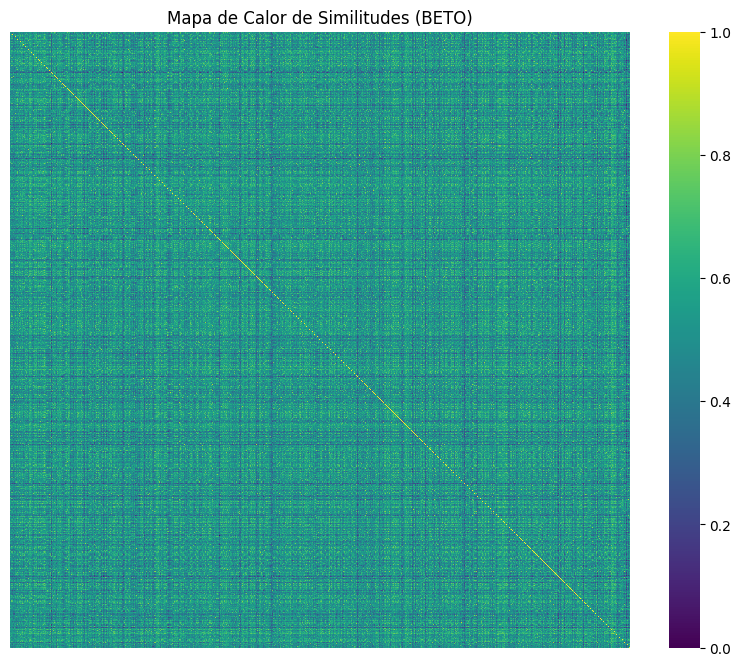


🔹 Generando heatmap para SPECTER...


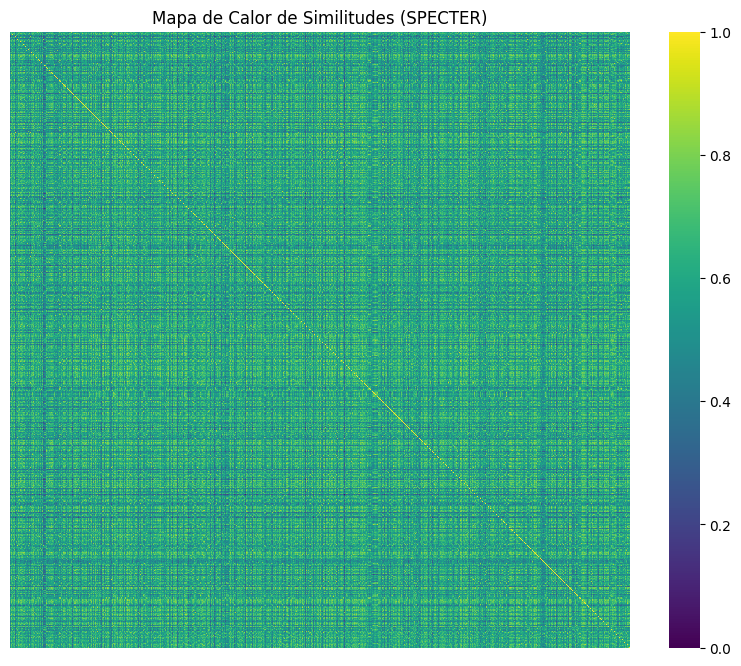


🔹 Generando heatmap para BERTIN...


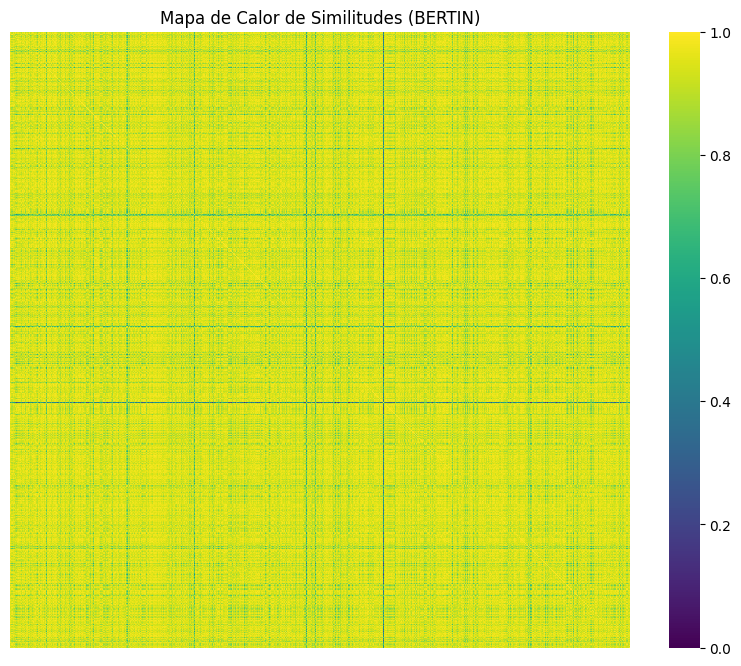


🔹 Generando heatmap para MiniLM_ES...


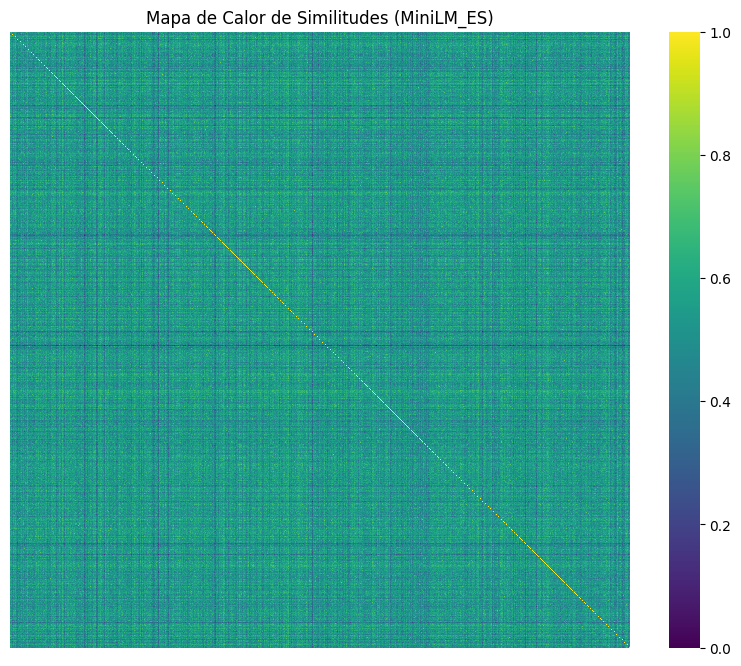


🔹 Generando heatmap para RoBERTa_BNE...


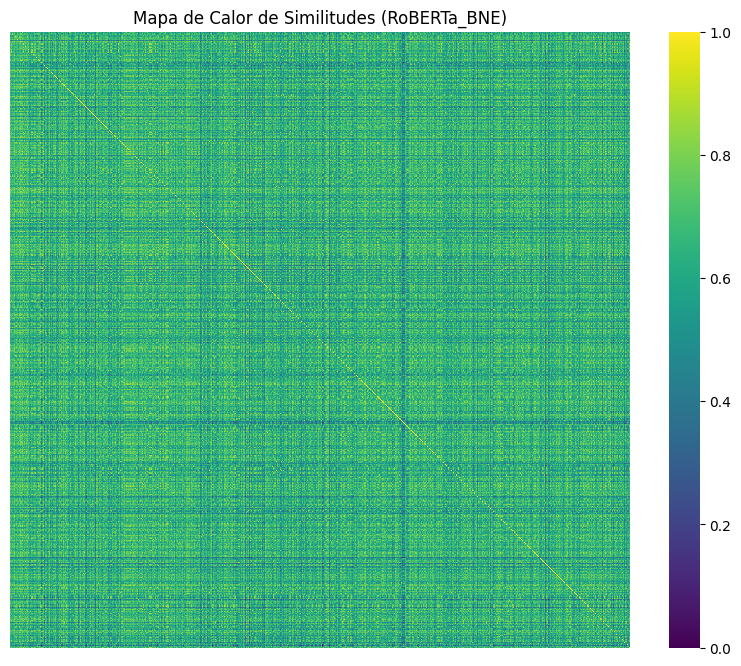


🔹 Generando heatmap para SciBERT_NLI...


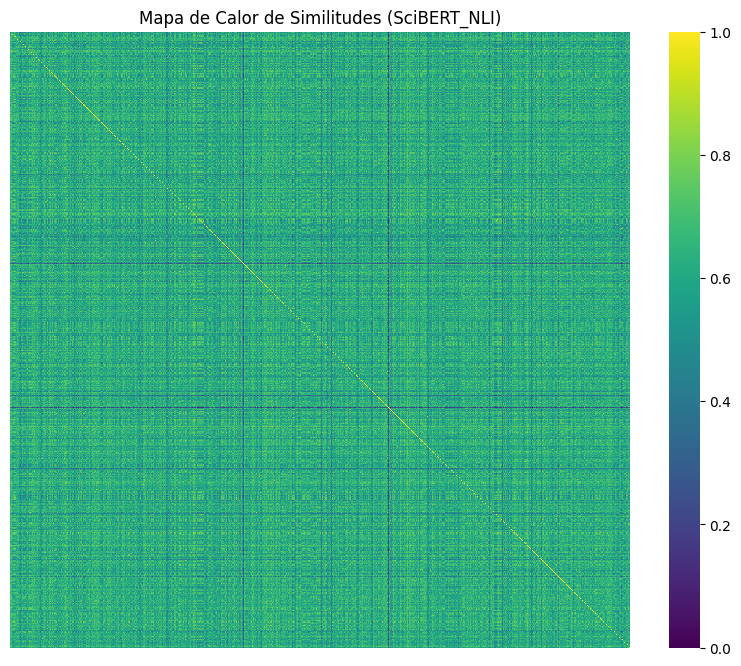

In [ ]:
import dask.dataframe as dd
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def graficar_heatmap_similitud(model, sample_size=1000):
    print(f"\n🔹 Generando heatmap para {model}...")

    try:
        # 📌 Cargar la matriz de similitud con Dask
        file_path = f"/content/similarity_matrices/similarity_matrix_{model}.parquet"
        df_sim = dd.read_parquet(file_path)

        # 📌 Convertir a Dask Array con chunksize definido
        matrix = df_sim.to_dask_array().compute_chunk_sizes()

        # 📌 Muestrear filas y columnas si la matriz es demasiado grande
        n_samples = min(sample_size, matrix.shape[0])  # Evitar errores si hay menos datos
        indices = da.random.choice(matrix.shape[0], size=n_samples, replace=False)

        # 📌 Seleccionar la submatriz para graficar
        matrix_sampled = matrix[indices][:, indices].compute()

        # 📌 Normalizar matriz para mejorar visibilidad
        matrix_sampled = (matrix_sampled - np.min(matrix_sampled)) / (np.max(matrix_sampled) - np.min(matrix_sampled))

        # 📌 Graficar heatmap con escala ajustada
        plt.figure(figsize=(10, 8))
        sns.heatmap(matrix_sampled, cmap="viridis", xticklabels=False, yticklabels=False, vmin=0, vmax=1)
        plt.title(f"Mapa de Calor de Similitudes ({model})")
        plt.show()

    except Exception as e:
        print(f"❌ Error procesando {model}: {str(e)}")

# 📌 Ejecutar para cada modelo
modelos = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]
for modelo in modelos:
    graficar_heatmap_similitud(modelo)


🔹 Procesando BETO...
🔹 Procesando SPECTER...
🔹 Procesando BERTIN...
🔹 Procesando MiniLM_ES...
🔹 Procesando RoBERTa_BNE...
🔹 Procesando SciBERT_NLI...


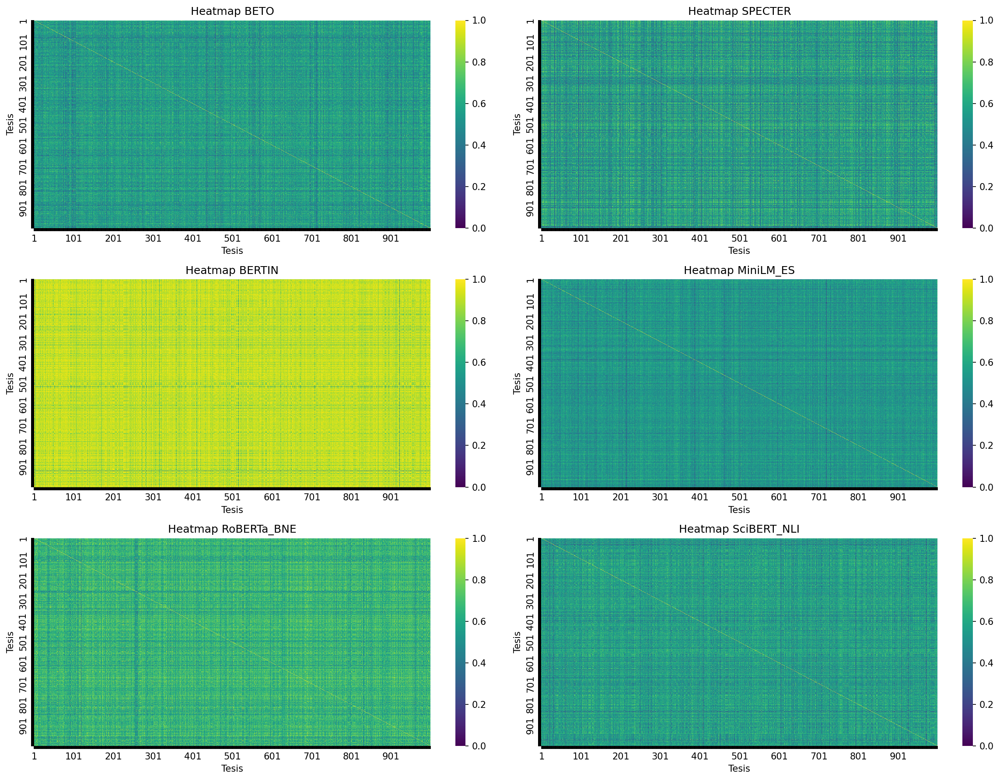

In [ ]:
import dask.dataframe as dd
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def graficar_heatmaps_modelos(modelos, sample_size=1000, step_label=100):
    n_modelos = len(modelos)
    n_cols = 2  # Dos columnas de subplots
    n_rows = (n_modelos + n_cols - 1) // n_cols  # Calcular filas necesarias

    # Crear figura con alta resolución
    plt.figure(figsize=(16, 4 * n_rows), dpi=150)

    for i, model in enumerate(modelos):
        print(f"🔹 Procesando {model}...")
        try:
            # Cargar matriz de similitud
            file_path = f"/content/similarity_matrices/similarity_matrix_{model}.parquet"
            df_sim = dd.read_parquet(file_path)

            # Convertir a Dask Array
            matrix = df_sim.to_dask_array().compute_chunk_sizes()

            # Muestrear submatriz si es muy grande
            n_samples = min(sample_size, matrix.shape[0])
            indices = da.random.choice(matrix.shape[0], size=n_samples, replace=False)
            matrix_sampled = matrix[indices][:, indices].compute()

            # Normalizar para visualización
            matrix_sampled = (matrix_sampled - np.min(matrix_sampled)) / (np.max(matrix_sampled) - np.min(matrix_sampled))

            # Crear etiquetas cada `step_label` tesis
            etiquetas = [f"{j+1}" if j % step_label == 0 else "" for j in range(n_samples)]

            # Subplot
            ax = plt.subplot(n_rows, n_cols, i+1)
            sns.heatmap(matrix_sampled, cmap="viridis",
                        xticklabels=etiquetas,
                        yticklabels=etiquetas,
                        vmin=0, vmax=1,
                        ax=ax)
            ax.set_title(f"Heatmap {model}", fontsize=12)
            ax.set_xlabel("Tesis")
            ax.set_ylabel("Tesis")

        except Exception as e:
            print(f"❌ Error procesando {model}: {str(e)}")

    plt.tight_layout()
    plt.show()


# Lista de modelos
modelos = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# Generar todos los heatmaps en una sola figura
graficar_heatmaps_modelos(modelos, sample_size=1000, step_label=100)


🔹 Procesando BETO...
🔹 Procesando SPECTER...
🔹 Procesando BERTIN...
🔹 Procesando MiniLM_ES...
🔹 Procesando RoBERTa_BNE...
🔹 Procesando SciBERT_NLI...


/tmp/ipython-input-4189345436.py:60: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Ajustar para dejar espacio a la colorbar


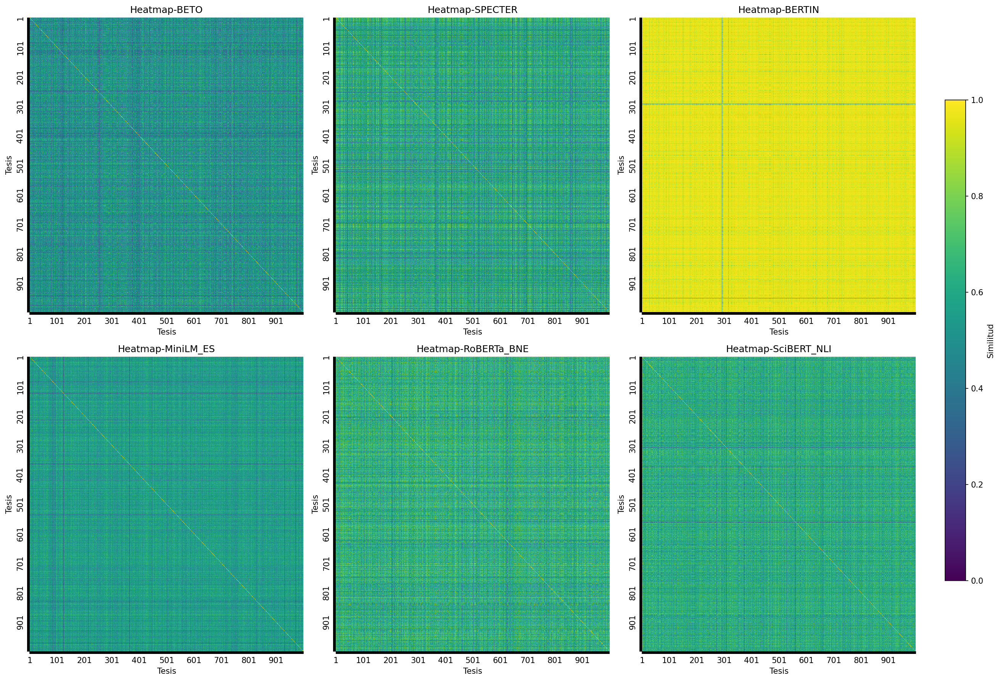

In [ ]:
import dask.dataframe as dd
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def graficar_heatmaps_grid(modelos, sample_size=1000, step_label=100):
    n_rows = 2
    n_cols = 3
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 12), dpi=150)

    # Para mantener la misma escala de color en todos
    vmin, vmax = 0, 1

    for idx, model in enumerate(modelos):
        row = idx // n_cols
        col = idx % n_cols
        ax = axes[row, col]
        print(f"🔹 Procesando {model}...")
        try:
            # Cargar matriz de similitud
            file_path = f"/content/similarity_matrices/similarity_matrix_{model}.parquet"
            df_sim = dd.read_parquet(file_path)

            # Convertir a Dask Array
            matrix = df_sim.to_dask_array().compute_chunk_sizes()

            # Muestrear submatriz si es muy grande
            n_samples = min(sample_size, matrix.shape[0])
            indices = da.random.choice(matrix.shape[0], size=n_samples, replace=False)
            matrix_sampled = matrix[indices][:, indices].compute()

            # Normalizar para visualización
            matrix_sampled = (matrix_sampled - np.min(matrix_sampled)) / (np.max(matrix_sampled) - np.min(matrix_sampled))

            # Crear etiquetas cada `step_label` tesis
            etiquetas = [f"{j+1}" if j % step_label == 0 else "" for j in range(n_samples)]

            # Graficar heatmap
            sns.heatmap(matrix_sampled, cmap="viridis",
                        xticklabels=etiquetas,
                        yticklabels=etiquetas,
                        vmin=vmin, vmax=vmax,
                        ax=ax,
                        cbar=False)
            ax.set_title(f"Heatmap-{model}", fontsize=12)
            ax.set_xlabel("Tesis")
            ax.set_ylabel("Tesis")

        except Exception as e:
            print(f"❌ Error procesando {model}: {str(e)}")

    # Agregar barra de color común a la derecha
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [x, y, width, height]
    norm = plt.Normalize(vmin=vmin, vmax=vmax)
    sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
    sm.set_array([])
    fig.colorbar(sm, cax=cbar_ax, label="Similitud")

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Ajustar para dejar espacio a la colorbar
    plt.show()


# Lista de modelos
modelos = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# Generar heatmaps en 2 filas x 3 columnas
graficar_heatmaps_grid(modelos, sample_size=1000, step_label=100)


# Gráficos de disperción con UMAP

In [ ]:
import pandas as pd
import umap
import matplotlib.pyplot as plt
import os
import numpy as np
from matplotlib.font_manager import FontProperties

# 📌 Configuración de UMAP
N_NEIGHBORS = 15
MIN_DIST = 0.1
METRIC = "cosine"
RANDOM_STATE = 42

# 📌 Modelos a graficar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Rutas de los archivos
input_folder = "/content/similarity_matrices/"
tesis_data_path = "/content/tesis_unsaac_filtrado.csv"

# 📌 Cargar datos originales con Facultad (ignorando filas con errores de formato)
df_tesis = pd.read_csv(tesis_data_path, on_bad_lines='skip', engine='python')

# 📌 Verificar columna 'Facultad'
if "Facultad" not in df_tesis.columns:
    raise ValueError("❌ La columna 'Facultad' no se encuentra en el archivo CSV.")

# 📌 Convertir Facultad a números (para colorear)
facultad_labels, facultad_index = pd.factorize(df_tesis["Facultad"])
num_facultades = len(facultad_index)

# 📌 Crear figura grande
fig, axes = plt.subplots(3, 2, figsize=(20, 20))
scatter = None  # Para usar luego en la leyenda

for i, model in enumerate(models):
    print(f"\n🔹 Generando gráfico UMAP para {model}...")

    # 📌 Cargar matriz de similitud
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")

    if not os.path.exists(file_path):
        print(f"⚠️ Archivo no encontrado: {file_path}")
        continue

    df_sim = pd.read_parquet(file_path)

    # 📌 Verificar que sea cuadrada
    if df_sim.shape[0] != df_sim.shape[1]:
        print(f"⚠️ La matriz de similitud para {model} no es cuadrada.")
        continue

    # 📌 Verificar coincidencia con df_tesis
    if df_sim.shape[0] != df_tesis.shape[0]:
        print(f"⚠️ Número de tesis no coincide con matriz de similitud en {model} ({df_sim.shape[0]} vs {df_tesis.shape[0]})")
        continue

    # 📌 Convertir a matriz NumPy
    matrix = df_sim.values

    # 📌 Reducir dimensiones con UMAP
    umap_model = umap.UMAP(
        n_components=2, metric=METRIC,
        n_neighbors=N_NEIGHBORS, min_dist=MIN_DIST,
        random_state=RANDOM_STATE
    )
    embedding_2d = umap_model.fit_transform(matrix)

    # 📌 Graficar en la subfigura
    ax = axes[i // 2, i % 2]
    scatter = ax.scatter(
        embedding_2d[:, 0], embedding_2d[:, 1],
        c=facultad_labels, cmap="tab10", alpha=0.6, s=10
    )
    ax.set_xlabel("UMAP Dim 1", fontsize=18)
    ax.set_ylabel("UMAP Dim 2", fontsize=18)

    ax.set_title(f"UMAP - {model}", fontsize=20)

# Paso 1: Obtener longitud de cada facultad
longitudes = sorted([len(fac) for fac in facultad_index])

# Paso 2: Obtener la longitud de la 4ta facultad más corta
umbral = longitudes[3] if len(longitudes) >= 5 else longitudes[-1]

# Paso 3: Función para insertar salto de línea sin cortar palabras
def salto_controlado(texto, max_len):
    if len(texto) <= max_len:
        return texto  # No necesita salto

    # Buscar el espacio más cercano antes de max_len
    espacio = texto.rfind(' ', 0, max_len)
    if espacio == -1:
        return texto  # No se puede cortar sin romper palabra
    return texto[:espacio] + '\n' + texto[espacio+1:]
# 📌 Agregar UNA SOLA leyenda si al menos un gráfico fue generado
if scatter:
    legend_labels = {
        idx: salto_controlado(facultad, umbral)
        for idx, facultad in enumerate(facultad_index)
    }

    legend_colors = [scatter.cmap(scatter.norm(i)) for i in range(num_facultades)]
    patches = [
        plt.Line2D([0], [0], marker='o', color='w',
                   markerfacecolor=legend_colors[i], markersize=8,
                   label=legend_labels[i])
        for i in range(num_facultades)
    ]
    font_prop = FontProperties(size=20)
    fig.legend(
        handles=patches,
        title="Facultad",
        title_fontsize=18,
        prop=font_prop,
        bbox_to_anchor=(1.05, 0.5),
        loc='center left',
    )

plt.tight_layout()
plt.show()

# 📌 Mostrar cuántas tesis fueron cargadas correctamente
print(f"\n✅ Total de tesis cargadas: {len(df_tesis)}")


In [ ]:
import pandas as pd
import umap
import os
import numpy as np
import plotly.express as px

# 📌 Configuración de UMAP
N_NEIGHBORS = 15
MIN_DIST = 0.1
METRIC = "cosine"
RANDOM_STATE = 42

# 📌 Modelos a graficar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Rutas de los archivos
input_folder = "/content/similarity_matrices/"
tesis_data_path = "/content/tesis_unsaac_filtrado.csv"  # Datos con Facultad y Escuela

# 📌 Cargar datos originales con Facultad y Título
df_tesis = pd.read_csv(tesis_data_path, on_bad_lines='skip', engine='python')

# 📌 Verificar columnas necesarias
required_columns = ["Titulo", "Facultad"]
missing_columns = [col for col in required_columns if col not in df_tesis.columns]
if missing_columns:
    raise ValueError(f"❌ Faltan columnas requeridas en el CSV: {missing_columns}")

# 📌 Filtrar solo las columnas necesarias
df_tesis = df_tesis[["Titulo", "Facultad"]]

# 📌 Convertir Facultad a números para mapear colores
facultad_labels, facultad_index = pd.factorize(df_tesis["Facultad"])
num_facultades = len(facultad_index)

# 📌 Generar gráficos interactivos por cada modelo
figs = []  # Lista para almacenar figuras

for model in models:
    print(f"\n🔹 Generando gráfico UMAP para {model}...")

    # 📌 Cargar matriz de similitud
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")

    if not os.path.exists(file_path):
        print(f"⚠️ Archivo no encontrado: {file_path}")
        continue

    df_sim = pd.read_parquet(file_path)

    # 📌 Validar que sea cuadrada y coincida con el número de tesis
    if df_sim.shape[0] != df_sim.shape[1]:
        print(f"⚠️ La matriz de similitud para {model} no es cuadrada.")
        continue
    if df_sim.shape[0] != df_tesis.shape[0]:
        print(f"⚠️ Número de tesis no coincide con matriz de similitud en {model} ({df_sim.shape[0]} vs {df_tesis.shape[0]})")
        continue

    # 📌 Convertir a matriz NumPy
    matrix = df_sim.values

    # 📌 Reducir dimensiones con UMAP
    umap_model = umap.UMAP(
        n_components=2, metric=METRIC,
        n_neighbors=N_NEIGHBORS, min_dist=MIN_DIST,
        random_state=RANDOM_STATE
    )
    embedding_2d = umap_model.fit_transform(matrix)

    # 📌 Crear DataFrame con coordenadas UMAP y metadatos
    df_umap = pd.DataFrame(embedding_2d, columns=["UMAP Dim 1", "UMAP Dim 2"])
    df_umap["Facultad"] = df_tesis["Facultad"]
    df_umap["Titulo"] = df_tesis["Titulo"]

    # 📌 Crear gráfico interactivo con Plotly
    fig = px.scatter(
        df_umap,
        x="UMAP Dim 1",
        y="UMAP Dim 2",
        color="Facultad",
        hover_data=["Titulo"],
        title=f"UMAP - {model}",
        color_discrete_sequence=px.colors.qualitative.Set1
    )

    figs.append(fig)

# 📌 Mostrar los gráficos interactivos
for fig in figs:
    fig.show()

# 📌 Mostrar cuántas tesis fueron cargadas correctamente
print(f"\n✅ Total de tesis cargadas: {len(df_tesis)}")


In [ ]:
import pandas as pd
import umap
import matplotlib.pyplot as plt
import os
import numpy as np
from matplotlib.font_manager import FontProperties

# 📌 Configuración de UMAP
N_NEIGHBORS = 15
MIN_DIST = 0.1
METRIC = "cosine"
RANDOM_STATE = 42

# 📌 Modelos a graficar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Rutas de los archivos
input_folder = "/content/similarity_matrices/"
tesis_data_path = "/content/tesis_unsaac_filtrado.csv"

# 📌 Cargar datos originales con Facultad (ignorando filas con errores de formato)
df_tesis = pd.read_csv(tesis_data_path, on_bad_lines='skip', engine='python')

# 📌 Verificar columna 'Facultad'
if "Facultad" not in df_tesis.columns:
    raise ValueError("❌ La columna 'Facultad' no se encuentra en el archivo CSV.")

# 📌 Convertir Facultad a números (para colorear)
facultad_labels, facultad_index = pd.factorize(df_tesis["Facultad"])
num_facultades = len(facultad_index)

# 📌 Crear figura grande
fig, axes = plt.subplots(3, 2, figsize=(20, 20))
scatter = None  # Para usar luego en la leyenda

for i, model in enumerate(models):
    print(f"\n🔹 Generando gráfico UMAP para {model}...")

    # 📌 Cargar matriz de similitud
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")

    if not os.path.exists(file_path):
        print(f"⚠️ Archivo no encontrado: {file_path}")
        continue

    df_sim = pd.read_parquet(file_path)

    # 📌 Verificar que sea cuadrada
    if df_sim.shape[0] != df_sim.shape[1]:
        print(f"⚠️ La matriz de similitud para {model} no es cuadrada.")
        continue

    # 📌 Verificar coincidencia con df_tesis
    if df_sim.shape[0] != df_tesis.shape[0]:
        print(f"⚠️ Número de tesis no coincide con matriz de similitud en {model} ({df_sim.shape[0]} vs {df_tesis.shape[0]})")
        continue

    # 📌 Convertir a matriz NumPy
    matrix = df_sim.values

    # 📌 Reducir dimensiones con UMAP
    umap_model = umap.UMAP(
        n_components=2, metric=METRIC,
        n_neighbors=N_NEIGHBORS, min_dist=MIN_DIST,
        random_state=RANDOM_STATE
    )
    embedding_2d = umap_model.fit_transform(matrix)

    # 📌 Graficar en la subfigura
    ax = axes[i // 2, i % 2]
    scatter = ax.scatter(
        embedding_2d[:, 0], embedding_2d[:, 1],
        c=facultad_labels, cmap="tab10", alpha=0.6, s=10
    )
    ax.set_xlabel("UMAP Dim 1", fontsize=18)
    ax.set_ylabel("UMAP Dim 2", fontsize=18)

    ax.set_title(f"UMAP - {model}", fontsize=20)

# Paso 1: Obtener longitud de cada facultad
longitudes = sorted([len(fac) for fac in facultad_index])

# Paso 2: Obtener la longitud de la 4ta facultad más corta
umbral = longitudes[3] if len(longitudes) >= 5 else longitudes[-1]

# Paso 3: Función para insertar salto de línea sin cortar palabras
def salto_controlado(texto, max_len):
    if len(texto) <= max_len:
        return texto  # No necesita salto

    # Buscar el espacio más cercano antes de max_len
    espacio = texto.rfind(' ', 0, max_len)
    if espacio == -1:
        return texto  # No se puede cortar sin romper palabra
    return texto[:espacio] + '\n' + texto[espacio+1:]
# 📌 Agregar UNA SOLA leyenda si al menos un gráfico fue generado
if scatter:
    legend_labels = {
        idx: salto_controlado(facultad, umbral)
        for idx, facultad in enumerate(facultad_index)
    }

    legend_colors = [scatter.cmap(scatter.norm(i)) for i in range(num_facultades)]
    patches = [
        plt.Line2D([0], [0], marker='o', color='w',
                   markerfacecolor=legend_colors[i], markersize=8,
                   label=legend_labels[i])
        for i in range(num_facultades)
    ]
    font_prop = FontProperties(size=20)
    fig.legend(
        handles=patches,
        title="Facultad",
        title_fontsize=18,
        prop=font_prop,
        bbox_to_anchor=(1.05, 0.5),
        loc='center left',
    )

plt.tight_layout()
plt.show()

# 📌 Mostrar cuántas tesis fueron cargadas correctamente
print(f"\n✅ Total de tesis cargadas: {len(df_tesis)}")

In [ ]:
import pandas as pd
import umap
import os
import numpy as np
import plotly.express as px

# 📌 Configuración de UMAP
N_NEIGHBORS = 15
MIN_DIST = 0.1
METRIC = "cosine"
RANDOM_STATE = 42

# 📌 Modelos a graficar
models = ["BETO", "SPECTER", "BERTIN", "MiniLM_ES", "RoBERTa_BNE", "SciBERT_NLI"]

# 📌 Rutas de los archivos
input_folder = "/content/similarity_matrices/"
tesis_data_path = "/content/tesis_unsaac_filtrado.csv"  # Datos con Escuela y Título

# 📌 Cargar datos originales con Escuela y Título
df_tesis = pd.read_csv(tesis_data_path)

# 📌 Verificar columnas y extraer datos necesarios
print(df_tesis.columns)  # Asegúrate de que contiene "Escuela" y "Título"
df_tesis = df_tesis[["Titulo", "Escuela"]]

# 📌 Convertir Escuela a números para mapear colores
escuela_labels, escuela_index = pd.factorize(df_tesis["Escuela"])
num_escuelas = len(escuela_index)

# 📌 Generar gráficos interactivos por cada modelo
figs = []  # Lista para almacenar figuras

for model in models:
    print(f"\n🔹 Generando gráfico UMAP para {model}...")

    # 📌 Cargar matriz de similitud
    file_path = os.path.join(input_folder, f"similarity_matrix_{model}.parquet")
    df_sim = pd.read_parquet(file_path)

    # 📌 Convertir a matriz NumPy
    matrix = df_sim.values

    # 📌 Reducir dimensiones con UMAP
    umap_model = umap.UMAP(n_components=2, metric=METRIC, n_neighbors=N_NEIGHBORS,
                           min_dist=MIN_DIST, random_state=RANDOM_STATE)
    embedding_2d = umap_model.fit_transform(matrix)

    # 📌 Verificar que los datos coincidan con la matriz de similitud
    if len(df_tesis) != len(embedding_2d):
        print(f"⚠️ Error: Número de tesis ({len(df_tesis)}) no coincide con datos de similitud ({len(embedding_2d)})")
        continue

    # 📌 Crear DataFrame con coordenadas UMAP y metadatos
    df_umap = pd.DataFrame(embedding_2d, columns=["UMAP Dim 1", "UMAP Dim 2"])
    df_umap["Escuela"] = df_tesis["Escuela"]
    df_umap["Titulo"] = df_tesis["Titulo"]

    # 📌 Crear gráfico interactivo con Plotly
    fig = px.scatter(df_umap, x="UMAP Dim 1", y="UMAP Dim 2",
                     color="Escuela", hover_data=["Titulo"],
                     title=f"UMAP - {model}",
                     color_discrete_sequence=px.colors.qualitative.Set3)

    figs.append(fig)  # Guardar la figura

# 📌 Mostrar los gráficos interactivos
for fig in figs:
    fig.show()


# Neo4j

In [ ]:
!pip install --upgrade neo4j

In [ ]:
from neo4j import GraphDatabase

# 🔹 Datos de tu nueva instancia
NEO4J_URI = "neo4j+s://3ca8e45c.databases.neo4j.io"
NEO4J_USER = "neo4j"
NEO4J_PASSWORD = "JEv6rEzTYF9BeNPkybvqtYpxeV3GCxL_L-RMQ1FxGtk"

# Crear el driver
driver = GraphDatabase.driver(NEO4J_URI, auth=(NEO4J_USER, NEO4J_PASSWORD))

# Función para probar la conexión
def test_connection(tx):
    result = tx.run("RETURN 'Conexión exitosa con Neo4j AuraDB' AS mensaje")
    for record in result:
        print(record["mensaje"])

# Ejecutar la prueba
with driver.session() as session:
    session.execute_read(test_connection)

# Cerrar la conexión
driver.close()


In [ ]:
import pandas as pd

df_tesis = pd.read_csv('/content/tesis_unsaac_filtrado.csv').fillna("")
print(f"Número de tesis cargadas: {len(df_tesis)}")
df_tesis.head()


In [ ]:
def insert_unique_escuelas_facultades(tx, rows):
    query = """
    UNWIND $rows AS row
    MERGE (e:Escuela {nombre: row.Escuela})
    MERGE (f:Facultad {nombre: row.Facultad})
    MERGE (e)-[:PERTENECE_A]->(f)
    SET e.id = row.Id
    """
    tx.run(query, rows=rows)

# Preparar lista de diccionarios
rows = escuelas.to_dict('records')

with driver.session() as session:
    session.execute_write(insert_unique_escuelas_facultades, rows)

print("✅ Nodos de Escuela y Facultad creados (batch)")


In [ ]:
def relacionar_tesis_batch(tx, rows):
    query = """
    UNWIND $rows AS row
    MATCH (t:Tesis {id: row.id_tesis})
    MATCH (e:Escuela {nombre: row.escuela})
    MERGE (t)-[:PERTENECE_A]->(e)
    """
    tx.run(query, rows=rows)

rows_rel = df_tesis[['Id', 'Escuela']].rename(columns={'Id':'id_tesis'}).to_dict('records')

with driver.session() as session:
    session.execute_write(relacionar_tesis_batch, rows_rel)

print("✅ Relaciones TESIS -> ESCUELA creadas (batch)")


In [ ]:
df_sim = pd.read_csv('/content/roberta_bne_comparaciones_filtradas.csv')
df_sim = df_sim.dropna(subset=["Tesis_1", "Tesis_2", "Similitud"])
rows_sim = df_sim.to_dict('records')

def create_similarity_batch(tx, rows):
    query = """
    UNWIND $rows AS row
    MATCH (t1:Tesis {id: row.Tesis_1})
    MATCH (t2:Tesis {id: row.Tesis_2})
    MERGE (t1)-[r:SIMILAR]->(t2)
    SET r.similitud = row.Similitud
    """
    tx.run(query, rows=rows)

# Ejecutar en batches de 5000 para no colgar Colab
batch_size = 5000
for i in range(0, len(rows_sim), batch_size):
    batch = rows_sim[i:i+batch_size]
    with driver.session() as session:
        session.execute_write(create_similarity_batch, batch)
    print(f"✅ Batch {i//batch_size + 1} de {(len(rows_sim)-1)//batch_size + 1} creado")

In [ ]:

# ===============================
# 2️⃣ Leer archivo CSV
# ===============================
df_ids = pd.read_csv('/content/ids_escuelas_facultades.csv').fillna("")
print(f"Filas cargadas: {len(df_ids)}")

# ===============================
# 3️⃣ Crear nodos Facultad y Escuela Profesional
# ===============================
def crear_escuela_facultad(tx, rows):
    query = """
    UNWIND $rows AS row
    MERGE (f:Facultad {nombre: row.Facultad})
    MERGE (e:Escuela {nombre: row.Escuela})
    MERGE (e)-[:PERTENECE_A]->(f)
    """
    tx.run(query, rows=rows)

# Tomar solo combinaciones únicas Escuela-Facultad
rows_escuelas = df_ids[['Escuela','Facultad']].drop_duplicates().to_dict('records')
with driver.session() as session:
    session.execute_write(crear_escuela_facultad, rows_escuelas)

print("✅ Nodos únicos de Escuela y Facultad creados")

# ===============================
# 4️⃣ Relacionar TESIS con su Escuela
# ===============================
def relacionar_tesis_escuela(tx, rows):
    query = """
    UNWIND $rows AS row
    MATCH (t:Tesis {id: row.Id})
    MATCH (e:Escuela {nombre: row.Escuela})
    MERGE (t)-[:PERTENECE_A]->(e)
    """
    tx.run(query, rows=rows)

# Filtrar tesis que tienen Escuela no vacía
rows_tesis = df_ids[df_ids['Escuela'] != ""][['Id','Escuela']].to_dict('records')
with driver.session() as session:
    session.execute_write(relacionar_tesis_escuela, rows_tesis)

print("✅ Relaciones TESIS -> Escuela creadas")


In [ ]:
driver.close()
print("✅ Conexión cerrada")
